<a href="https://colab.research.google.com/github/samyaahsan/cv_quantifying_food/blob/main/operators.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Sobel Operator

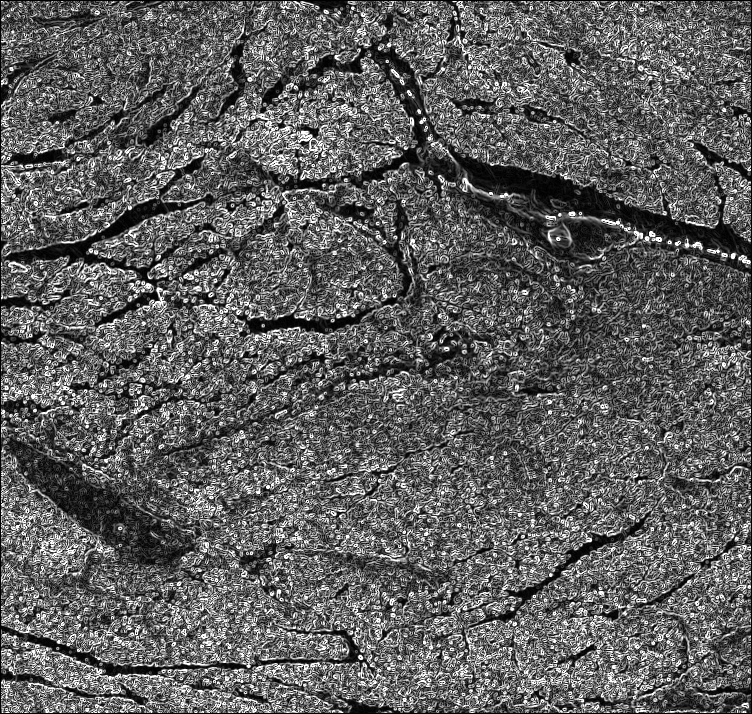

In [ ]:
import cv2
from matplotlib import pyplot as plt
import numpy as np
import math
from matplotlib import cm

def sobel(img):
  g_X = np.matrix([[-1, 0 , 1], 
                  [-2, 0, 2], 
                  [-1, 0, 1]])
  
  g_Y = np.matrix([[-1, -2, -1], 
                  [0, 0, 0], 
                  [1, 2, 1]])
  
  [rows, cols] = np.shape(img)
  sobel_image = np.zeros(shape=(rows, cols))
  i = 0;
  
  #rows by columns
  for i in range(rows - 2):
    for j in range(cols - 2):
      #pix_x = (g_X[0][0] * img[x-1][y-1]) + (g_X[0][1] * img[x][y-1]) + (g_X[0][2] * img[x+1][y-1]) + (g_X[1][0] * img[x-1][y]) + (g_X[1][1] * img[x][y])+ (g_X[1][2] * img[x+1][y]) + (g_X[2][0] * img[x-1][y+1]) + (g_X[2][1] * img[x][y+1]) + (g_X[2][2] * img[x+1][y+1])
      
      #iterate over a 3x3 grid, compute dot product, and sum to find g_x and g_y values
      pix_x = np.sum(np.multiply(g_X, img[i:i+3, j:j+3]))
      pix_y = np.sum(np.multiply(g_Y, img[i:i+3, j:j+3]))
      #pix_y = (g_Y[0][0] * img[x-1][y-1]) + (g_Y[0][1] * img[x][y-1]) + (g_Y[0][2] * img[x+1][y-1]) + (g_Y[1][0] * img[x-1][y]) + (g_Y[1][1] * img[x][y])+ (g_Y[1][2] * img[x+1][y]) + (g_Y[2][0] * img[x-1][y+1]) + (g_Y[2][1] * img[x][y+1]) + (g_Y[2][2] * img[x+1][y+1])     
      #compute final gradient value: sqrt(g_x^2 + g_y^2)
      #G = math.sqrt((pix_x * pix_x) + (pix_y + pix_y))
      sobel_image[i+1, j+1] = np.sqrt((pix_x * pix_x) + (pix_y * pix_y))
      

  cv2_imshow(sobel_image)
  '''
  fig1 = plt.figure(1, figsize=(20,20))
  fig1.show()
  ax1 = fig1.add_subplot(121)
  fig2 = plt.figure(2, figsize=(20,20))
  fig2.show()
  ax2 = fig2.add_subplot(122)
  ax1.imshow(sobel_image, cmap='binary')
  ax2.imshow(sobel_image, cmap='plasma')
  '''
  

 # fig3 = plt.quiver(pix_x, pix_y)
  #fig3.show()


if __name__ == '__main__':
  img = cv2.imread('small_steak.jpg')
  #convert to grayscale
  img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
  sobel(img_gray)



  


In [ ]:
from google.colab.patches import cv2_imshow
import cv2
from matplotlib import pyplot as plt
import numpy as np
import math
from matplotlib import cm

if __name__ == '__main__':
  img = cv2.imread('small_steak.jpg')
  #img = bilateralFilter(src, dst, d, sigmaColor, sigmaSpace, borderType)
  #convert to grayscale
  img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

  #blur img [filter]
  blur_img = cv2.bilateralFilter(img_gray, 5, 15, 15)
  # Calculation of Sobelx
  sobelx = cv2.Sobel(blur_img,cv2.CV_64F,1,0,ksize=3)
    
  # Calculation of Sobely
  sobely = cv2.Sobel(blur_img,cv2.CV_64F,0,1,ksize=3)

  abs_grad_x = cv2.convertScaleAbs(sobelx)
  abs_grad_y = cv2.convertScaleAbs(sobely)

  

  grad = cv2.addWeighted(abs_grad_x, 0.5, abs_grad_y, 0.5, 0)

  #cv2_imshow(sobelx)
  #cv2_imshow(sobely)

  cv2_imshow(grad)


error: ignored

## Laplacian Operator

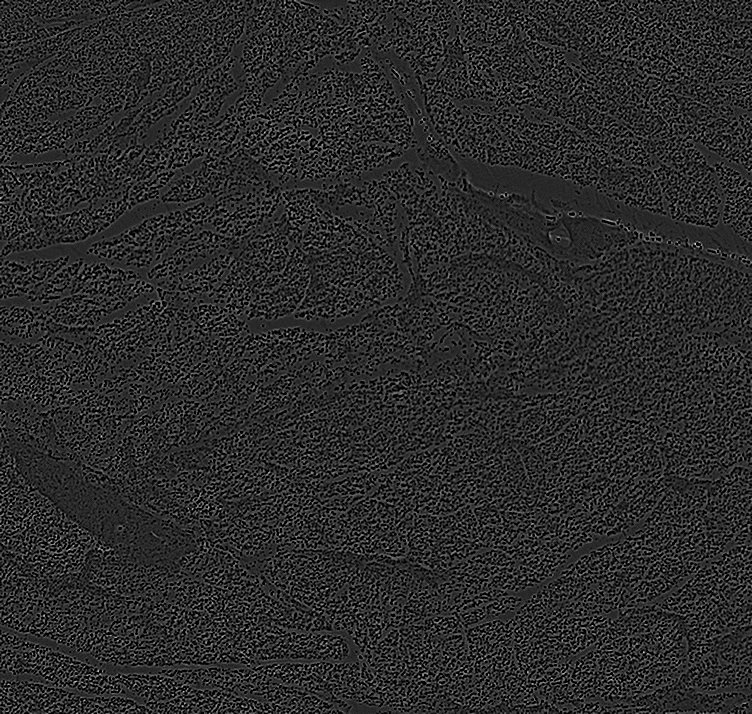

In [ ]:
import cv2
from matplotlib import pyplot as plt
import numpy as np
import math
from matplotlib import cm
from google.colab.patches import cv2_imshow

def laplace(img):
    blur = cv2.GaussianBlur(img, (3,3), 0)
    laplacian = cv2.Laplacian(blur, cv2.CV_64F)

    #laplacian_clip = laplacian/laplacian.max()

    #cv2_imshow(laplacian)

    #increasing contrast/brightness
    alpha = 2.5 # Simple contrast control
    beta = 40    # Simple brightness control

    new_image = np.zeros(laplacian.shape, laplacian.dtype)

    for y in range(laplacian.shape[0]):
      for x in range(laplacian.shape[1]):
            new_image[y,x] = np.clip(alpha*laplacian[y,x] + beta, 0, 255)

    cv2_imshow(new_image)
    cv2.waitKey(0)



if __name__ == '__main__':
  img = cv2.imread('small_steak.jpg')
  #convert to grayscale
  img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
  laplace(img_gray)



##Canny

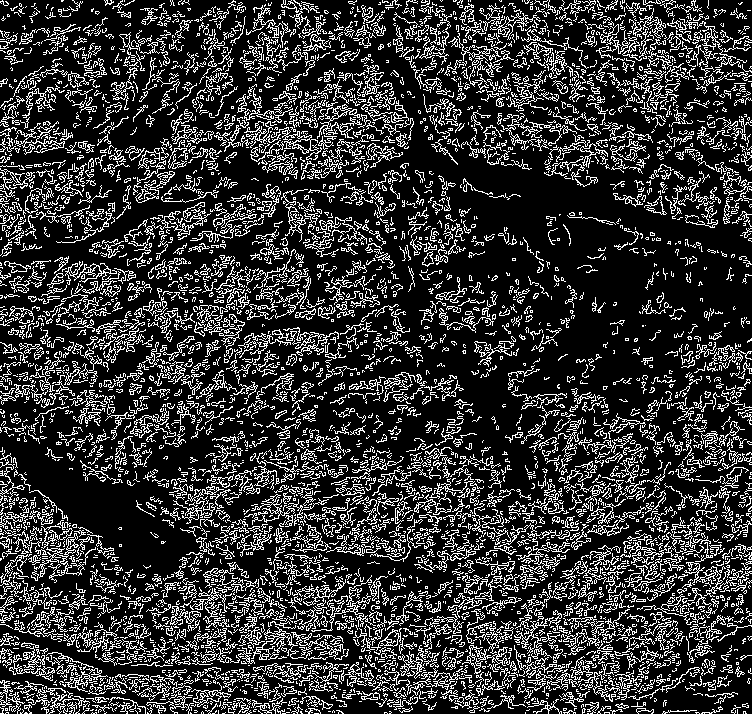

In [ ]:
def canny(img):
  edges = cv2.Canny(img, 100, 200, 3, L2gradient=True)
  cv2_imshow(edges)

if __name__ == '__main__':
  img = cv2.imread('small_steak.jpg')
  #convert to grayscale
  img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
  canny(img_gray)

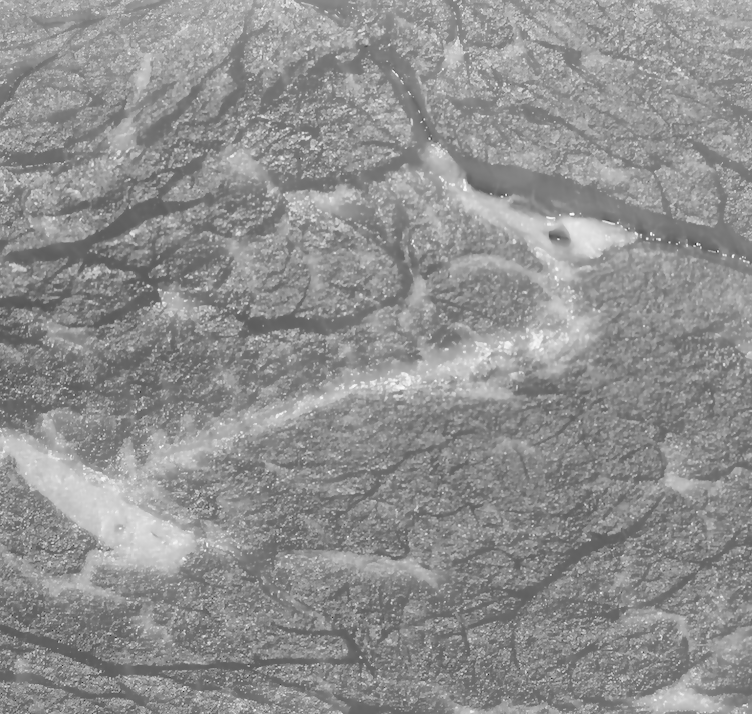

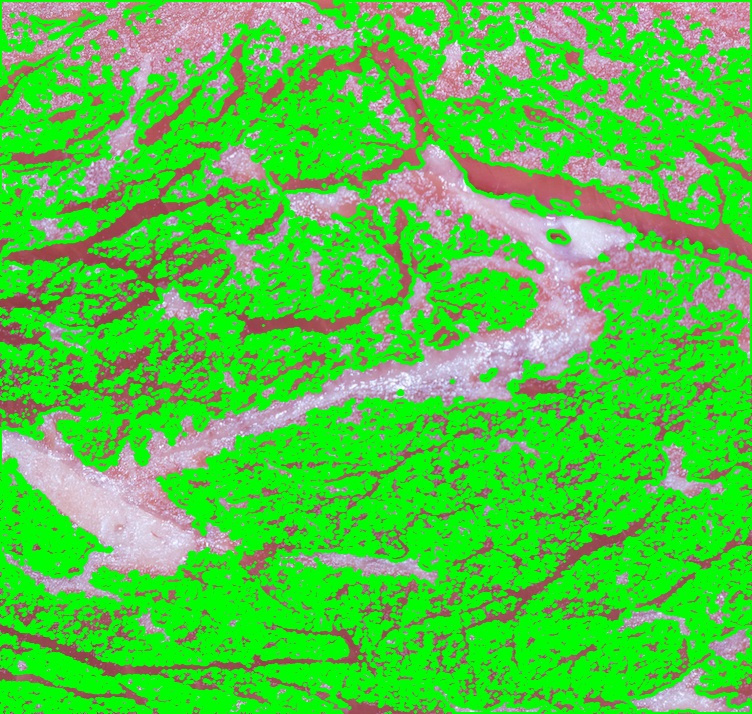

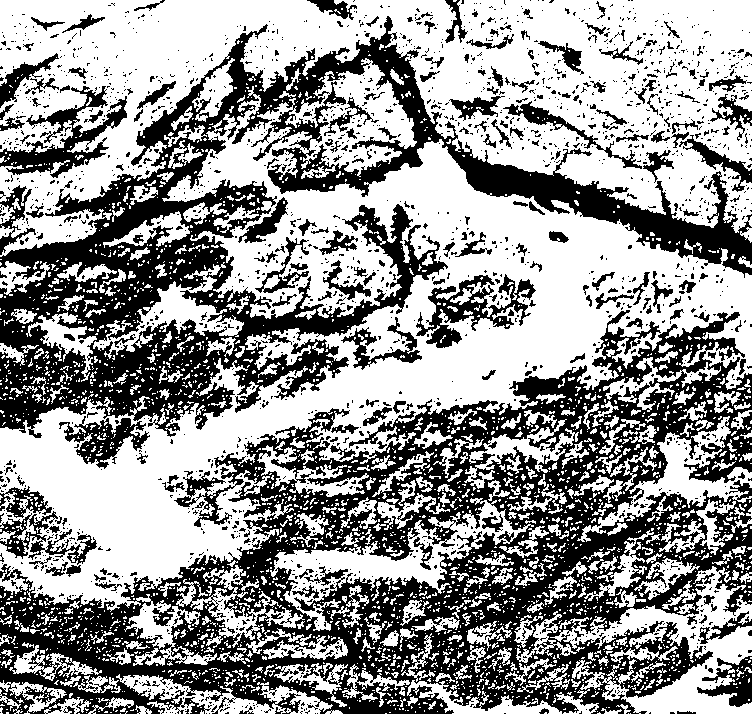

In [ ]:
import cv2

img = cv2.imread('small_steak.jpg')
#convert to grayscale
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
blur_img = cv2.bilateralFilter(img_gray, 5, 15, 15)
cv2_imshow(blur_img)
(T, threshInv) = cv2.threshold(blur_img, 135, 255, cv2.THRESH_BINARY)

# detect the contours on the binary image using cv2.CHAIN_APPROX_NONE
contours, hierarchy = cv2.findContours(image=threshInv, mode=cv2.RETR_TREE, method=cv2.CHAIN_APPROX_NONE)
                                     
# draw contours on the original image
image_copy = img.copy()
cv2.drawContours(image=image_copy, contours=contours, contourIdx=-1, color=(0, 255, 0), thickness=2, lineType=cv2.LINE_AA)
               
# see the results
cv2_imshow(image_copy)
cv2.waitKey(0)
cv2.imwrite('contours_none_image1.jpg', image_copy)
cv2.destroyAllWindows()
cv2_imshow(threshInv)


In [ ]:
import cv2

img = cv2.imread('small_steak.jpg')
#convert to grayscale
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
blur_img = cv2.bilateralFilter(img_gray, 5, 15, 15)
cv2_imshow(blur_img)
(T, threshInv) = cv2.threshold(blur_img, 175, 255, cv2.THRESH_BINARY)
cv2_imshow(threshInv)



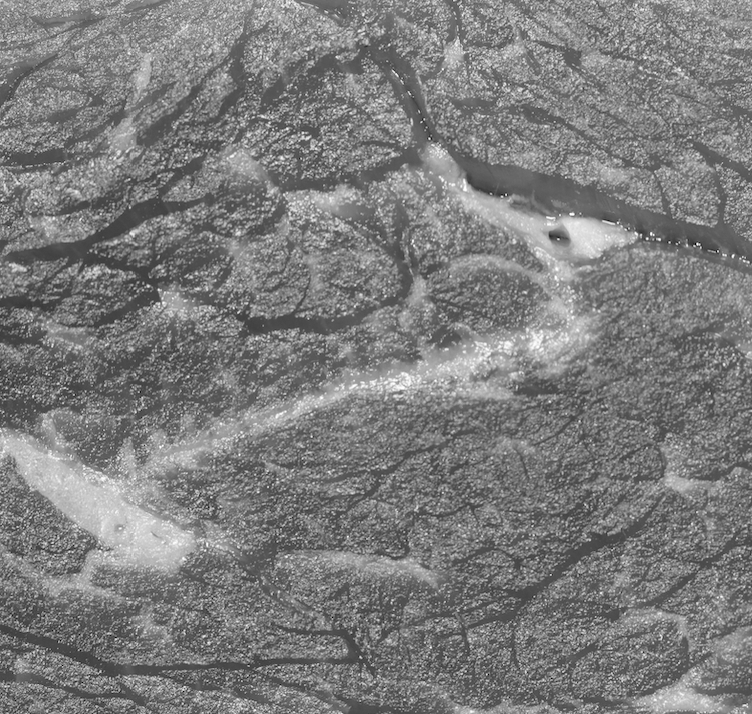

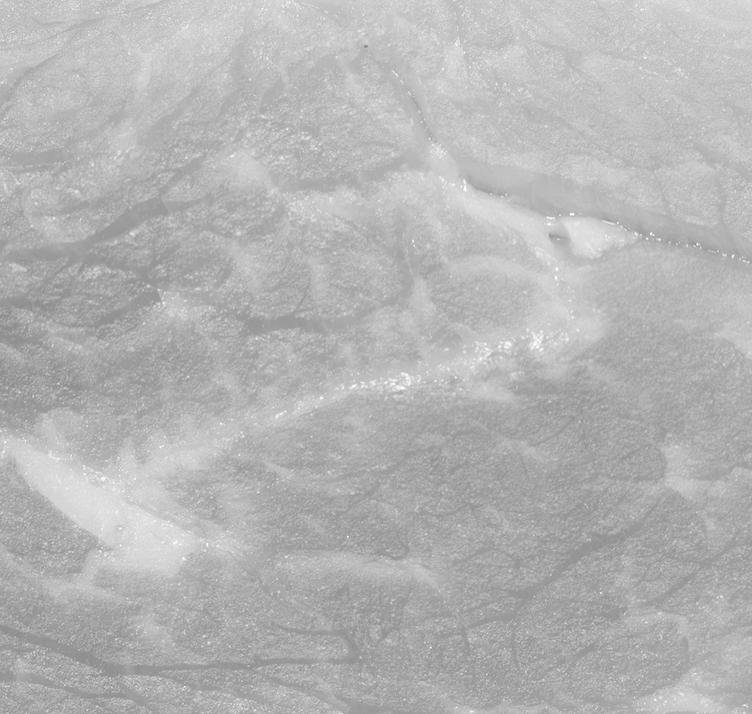

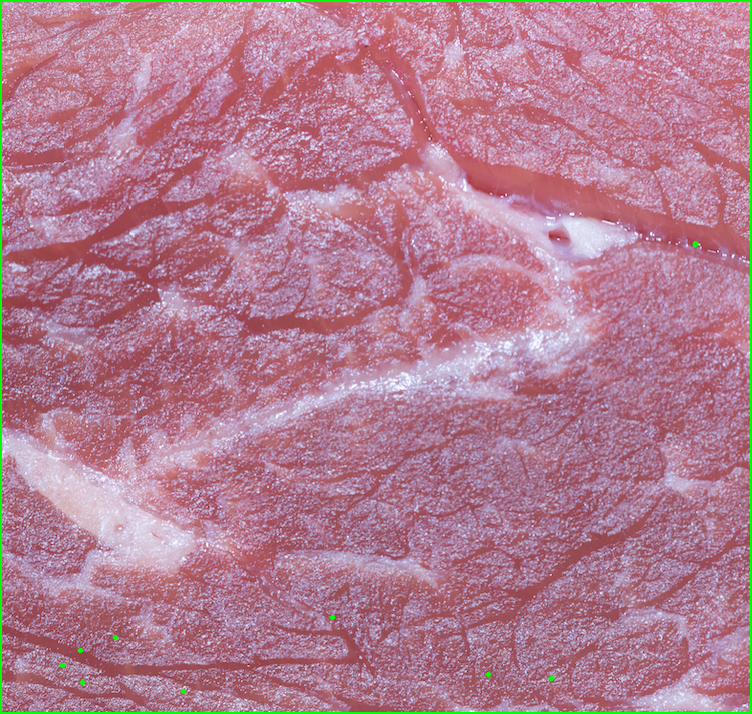

In [ ]:
import cv2
from google.colab.patches import cv2_imshow

# read the image
image = cv2.imread('small_steak.jpg')

# B, G, R channel splitting
blue, green, red = cv2.split(image)

cv2_imshow(green)
cv2_imshow(red)

# detect contours using green channel and without thresholding
contours2, hierarchy2 = cv2.findContours(image=green, mode=cv2.RETR_TREE, method=cv2.CHAIN_APPROX_NONE)
# draw contours on the original image
image_contour_green = image.copy()
cv2.drawContours(image=image_contour_green, contours=contours2, contourIdx=-1, color=(0, 255, 0), thickness=2, lineType=cv2.LINE_AA)
# see the results
#cv2.imshow("frame", image_contour_green)
cv2_imshow(image_contour_green)
cv2.waitKey(0)
cv2.imwrite('green_channel.jpg', image_contour_green)
cv2.destroyAllWindows()

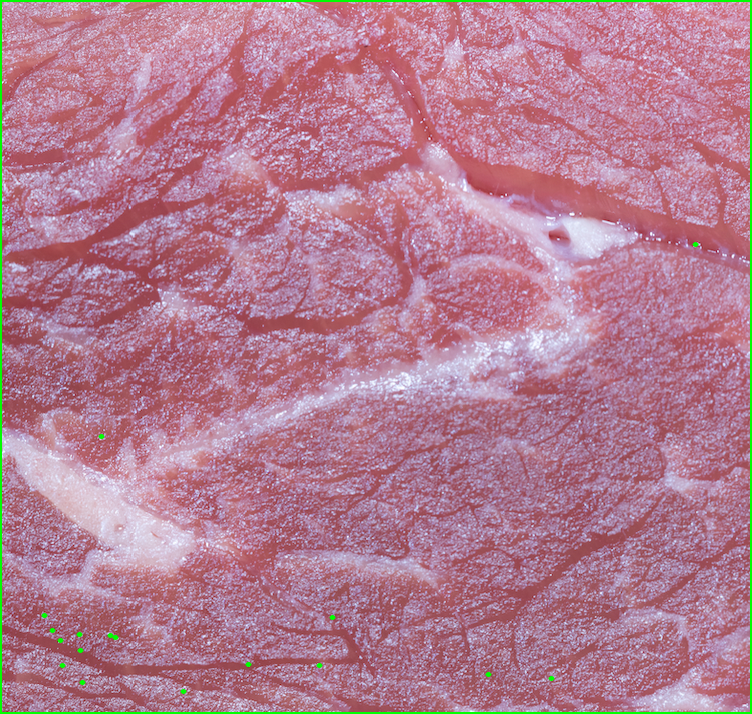

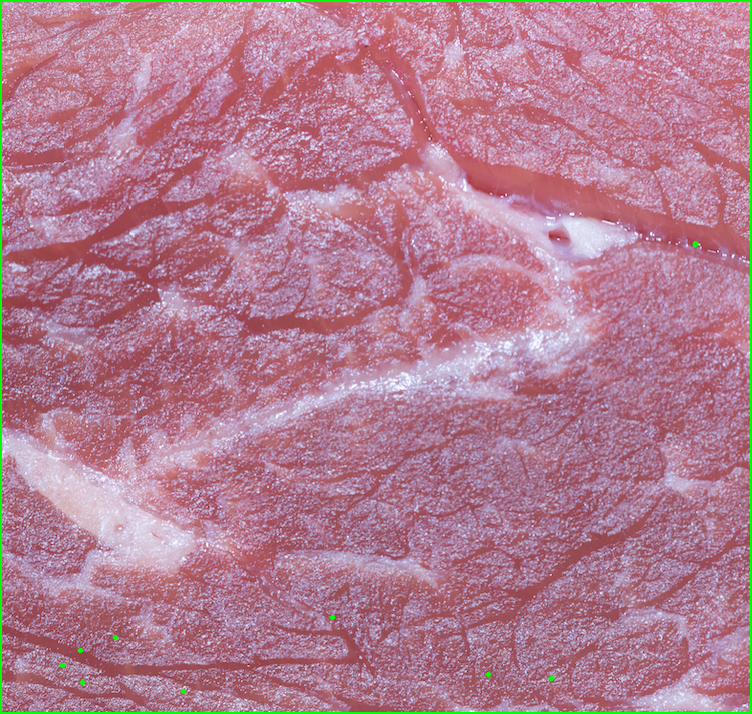

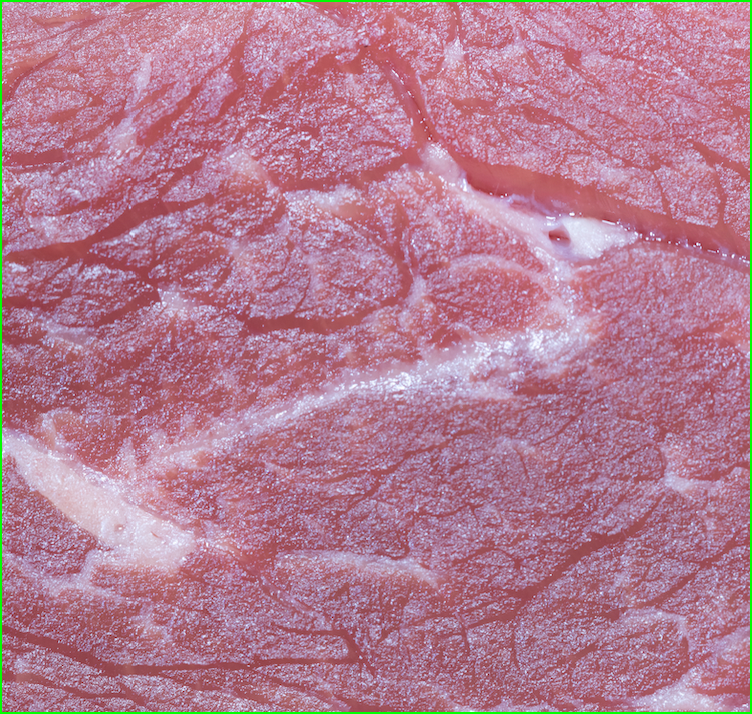

In [ ]:
import cv2

# read the image
image = cv2.imread('small_steak.jpg')

# B, G, R channel splitting
blue, green, red = cv2.split(image)

# detect contours using blue channel and without thresholding
contours1, hierarchy1 = cv2.findContours(image=blue, mode=cv2.RETR_TREE, method=cv2.CHAIN_APPROX_NONE)

# draw contours on the original image
image_contour_blue = image.copy()
cv2.drawContours(image=image_contour_blue, contours=contours1, contourIdx=-1, color=(0, 255, 0), thickness=2, lineType=cv2.LINE_AA)
# see the results
cv2_imshow(image_contour_blue)
cv2.waitKey(0)
cv2.imwrite('blue_channel.jpg', image_contour_blue)
cv2.destroyAllWindows()

# detect contours using green channel and without thresholding
contours2, hierarchy2 = cv2.findContours(image=green, mode=cv2.RETR_TREE, method=cv2.CHAIN_APPROX_NONE)
# draw contours on the original image
image_contour_green = image.copy()
cv2.drawContours(image=image_contour_green, contours=contours2, contourIdx=-1, color=(0, 255, 0), thickness=2, lineType=cv2.LINE_AA)
# see the results
cv2_imshow(image_contour_green)
cv2.waitKey(0)
cv2.imwrite('green_channel.jpg', image_contour_green)
cv2.destroyAllWindows()

# detect contours using red channel and without thresholding
contours3, hierarchy3 = cv2.findContours(image=red, mode=cv2.RETR_TREE, method=cv2.CHAIN_APPROX_NONE)
# draw contours on the original image
image_contour_red = image.copy()
cv2.drawContours(image=image_contour_red, contours=contours3, contourIdx=-1, color=(0, 255, 0), thickness=2, lineType=cv2.LINE_AA)
# see the results
cv2_imshow(image_contour_red)
cv2.waitKey(0)
cv2.imwrite('red_channel.jpg', image_contour_red)
cv2.destroyAllWindows()

In [ ]:
#move kernel over image
#if kernel contains x num. of pixels, keep it, else throw away


def clean(img):
  [rows, cols] = np.shape(img)
  clean_image = np.zeros(shape=(rows, cols))

  i = 0;
  #rows by columns
  for i in range(rows - 2):
    for j in range(cols - 2):
      #pix_x = (g_X[0][0] * img[x-1][y-1]) + (g_X[0][1] * img[x][y-1]) + (g_X[0][2] * img[x+1][y-1]) + (g_X[1][0] * img[x-1][y]) + (g_X[1][1] * img[x][y])+ (g_X[1][2] * img[x+1][y]) + (g_X[2][0] * img[x-1][y+1]) + (g_X[2][1] * img[x][y+1]) + (g_X[2][2] * img[x+1][y+1])
      
      #iterate over a 3x3 grid, compute dot product, and sum to find g_x and g_y values
      pix_x = np.sum(np.multiply(g_X, img[i:i+3, j:j+3]))
      pix_y = np.sum(np.multiply(g_Y, img[i:i+3, j:j+3]))
      #pix_y = (g_Y[0][0] * img[x-1][y-1]) + (g_Y[0][1] * img[x][y-1]) + (g_Y[0][2] * img[x+1][y-1]) + (g_Y[1][0] * img[x-1][y]) + (g_Y[1][1] * img[x][y])+ (g_Y[1][2] * img[x+1][y]) + (g_Y[2][0] * img[x-1][y+1]) + (g_Y[2][1] * img[x][y+1]) + (g_Y[2][2] * img[x+1][y+1])     
      #compute final gradient value: sqrt(g_x^2 + g_y^2)
      #G = math.sqrt((pix_x * pix_x) + (pix_y + pix_y))
      sobel_image[i+1, j+1] = np.sqrt((pix_x * pix_x) + (pix_y * pix_y))
      


sucks, don't use


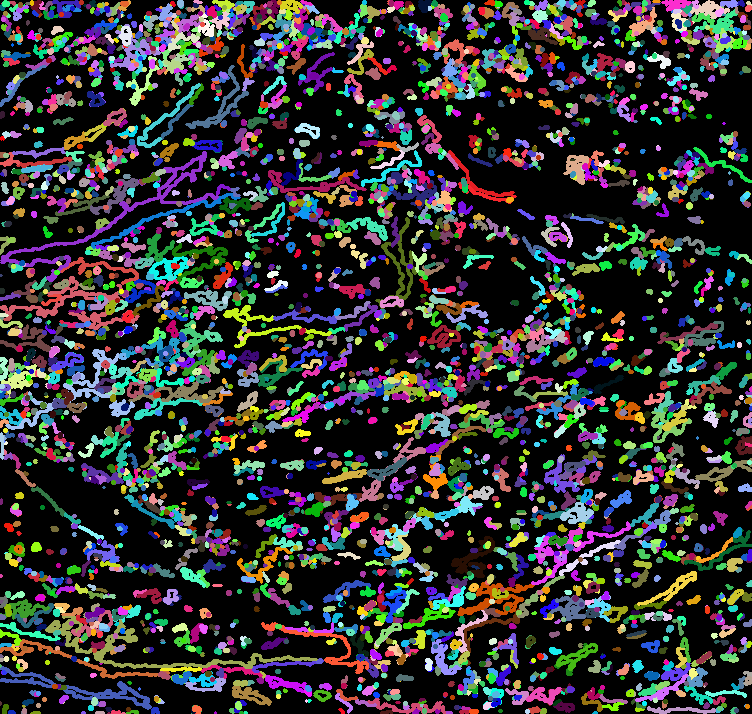

In [ ]:
from random import random, randrange, getrandbits, randint 
def contour(img):
# Detect edges using Canny

    threshold = 100
    canny_output = cv2.Canny(img, threshold, threshold * 2)
    # Find contours
    contours, hierarchy = cv2.findContours(canny_output, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    # Draw contours
    drawing = np.zeros((canny_output.shape[0], canny_output.shape[1], 3), dtype=np.uint8)
    for i in range(len(contours)):
        color = (randint(0,256), randint(0,256), randint(0,256))
        cv2.drawContours(drawing, contours, i, color, 2, cv2.LINE_8, hierarchy, 0)
    # Show in a window
    cv2_imshow(drawing)



if __name__ == '__main__':
  img = cv2.imread('green_steak.jpg')
  #convert to grayscale
  img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
  contour(img_gray)

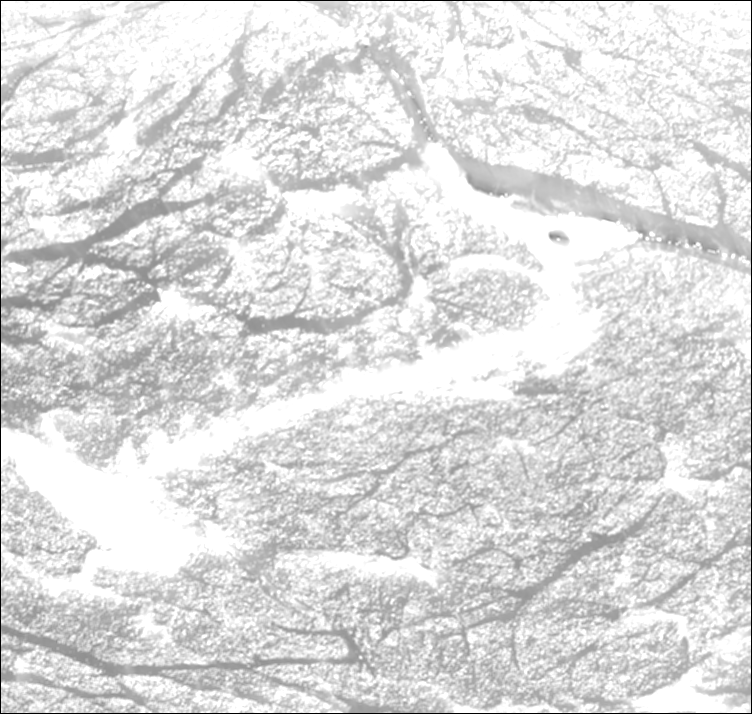

In [ ]:
##find only regions of interest
def interest(img):
  g_X = np.matrix([[-1, 0 , 1], 
                  [-2, 0, 2], 
                  [-1, 0, 1]])
  
  g_Y = np.matrix([[-1, -2, -1], 
                  [0, 0, 0], 
                  [1, 2, 1]])
  
  [rows, cols] = np.shape(img)
  interest_image = np.zeros(shape=(rows, cols))
  i = 0;
  
  #rows by columns
  for i in range(rows - 2):
    for j in range(cols - 2):

      pix_x = (np.sum(img[i:i+3, j:j+3])) / 8;
      pix_y =(np.sum(img[i:i+3, j:j+3])) / 8;

      interest_image[i+1, j+1] = np.sqrt((pix_x * pix_x) + (pix_y * pix_y))

  cv2_imshow(interest_image)

if __name__ == '__main__':
    img = cv2.imread('small_steak.jpg')
    #convert to grayscale
    img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    interest(img_gray)

    

It is quite easy to binarize the green component to separate meat from marbling by simple thresholding. Then use contouring.

In [ ]:
#1. threshold
#2. contour

In [ ]:
import cv2
import numpy as np

def green():

  ## Read
  img = cv2.imread("small_steak.jpg")

  ## convert to hsv
  hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

  ## mask of green (36,25,25) ~ (86, 255,255)
  # mask = cv2.inRange(hsv, (36, 25, 25), (86, 255,255))
  mask = cv2.inRange(hsv, (36, 25, 25), (70, 255,255))

  ## slice the green
  imask = mask>0
  green = np.zeros_like(img, np.uint8)
  green[imask] = img[imask]

  ## save 
  cv2.imwrite("mask.png", mask)
  #cv2_imshow(green)

if __name__ == '__main__':
    green()


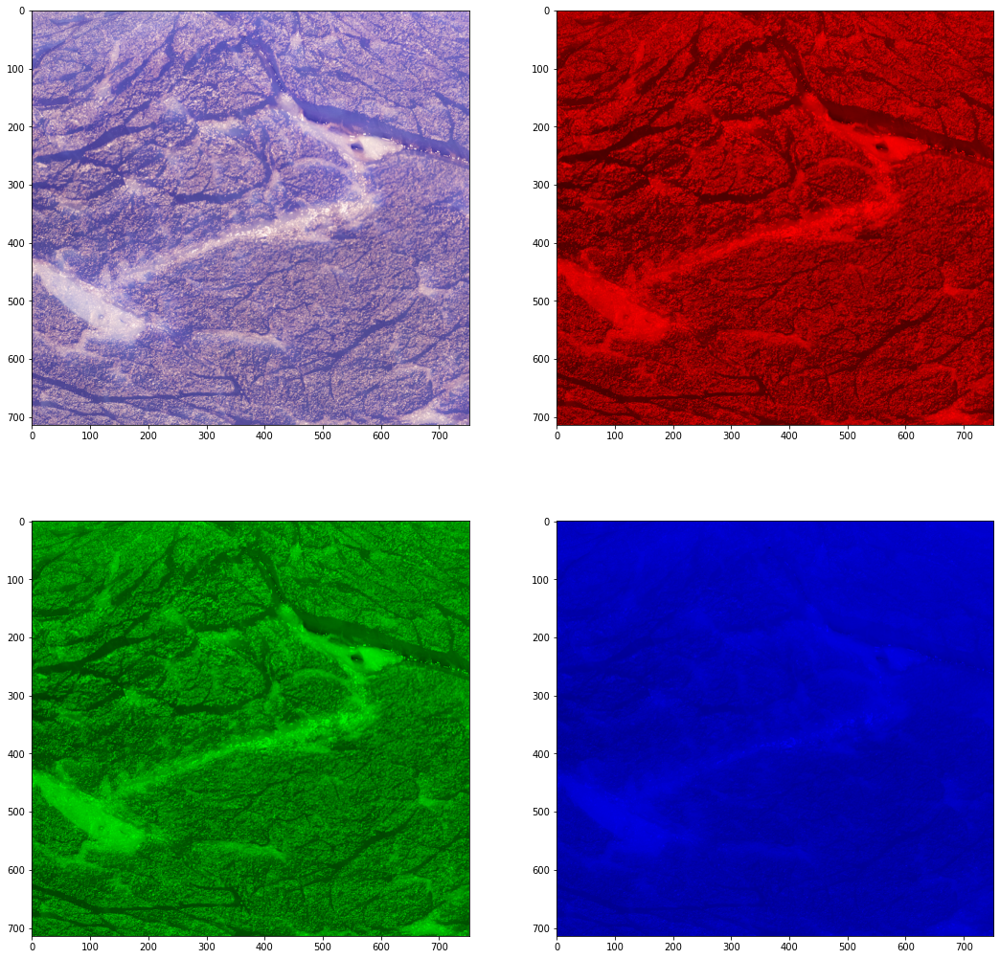

In [ ]:
import cv2
import matplotlib.pyplot as plt
    
img=cv2.imread("small_steak.jpg",1) 
    
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
R = img.copy() 
G = img.copy()
B = img.copy()

R[:,:,1] = R[:,:,2] = 0
G[:,:,0] = G[:,:,2] = 0
B[:,:,0] = B[:,:,1] = 0


fig = plt.figure(figsize=(18,18))
ax = fig.add_subplot(221)
bx = fig.add_subplot(222)
cx = fig.add_subplot(223)
dx = fig.add_subplot(224)

bx.imshow (R)
cx.imshow (G)
dx.imshow (B)
ax.imshow (img)



plt.show()

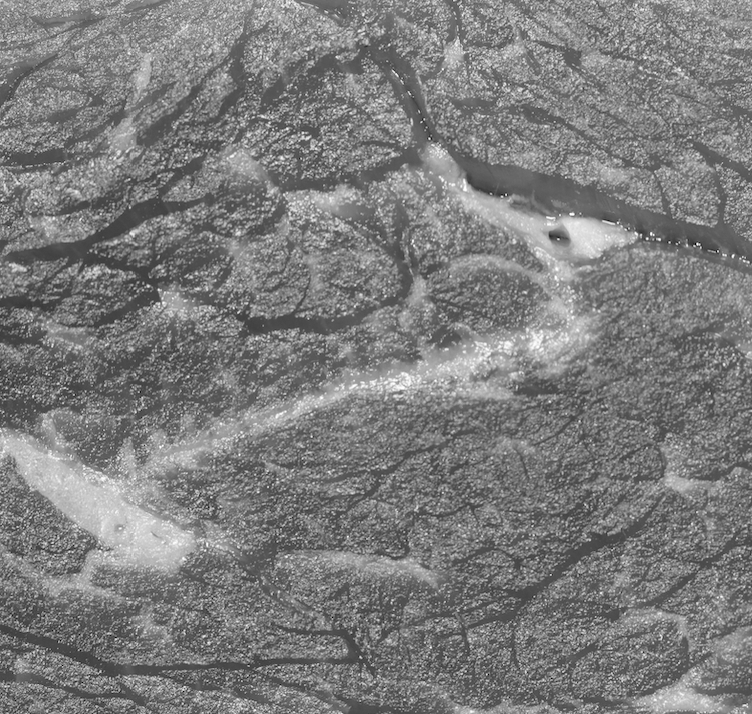

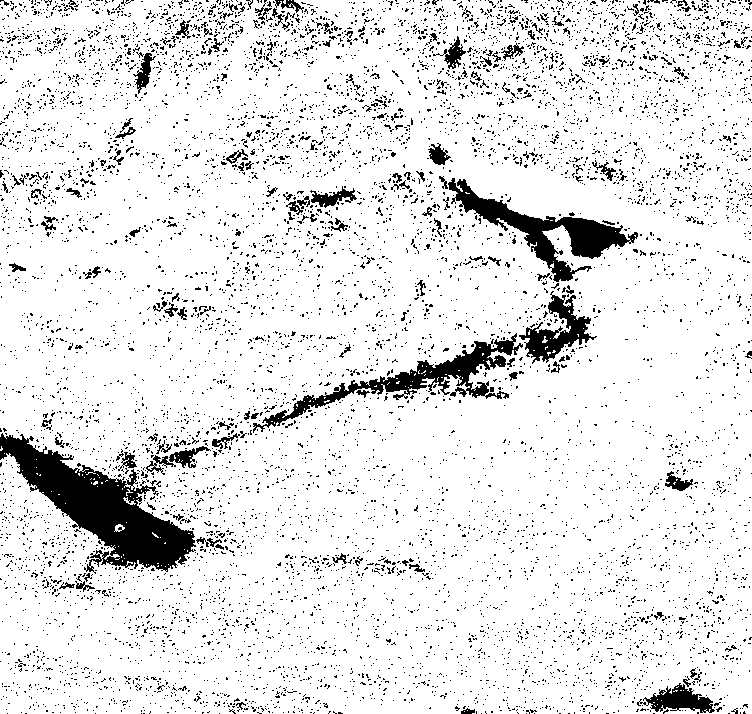

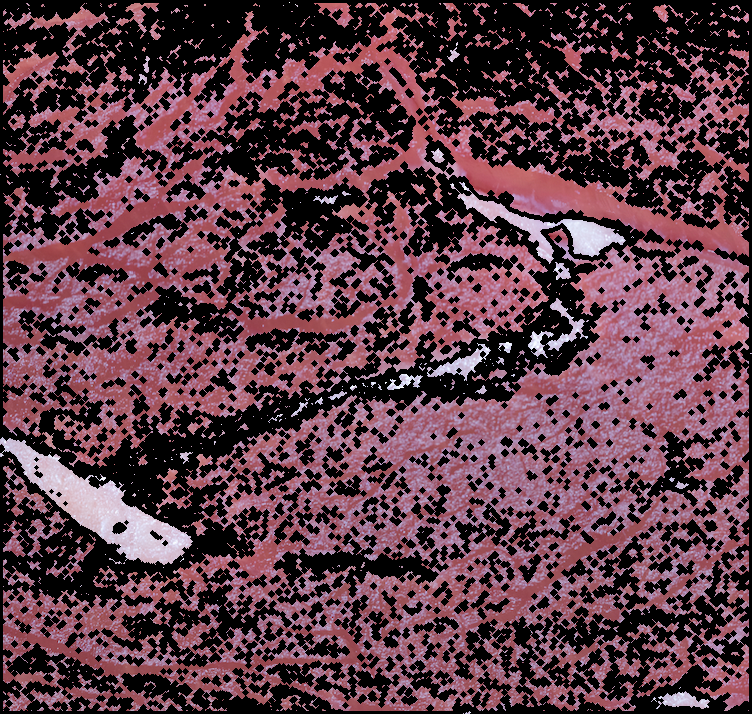

In [ ]:
#1. binarize the green component
  #a. get green component
  #b. binarize it
#2. use contouring


import cv2
from google.colab.patches import cv2_imshow

#read image
img = cv2.imread('small_steak.jpg')

#channel splitting
blue, green, red = cv2.split(img)
cv2_imshow(green)

#binarize green component
retval, dst	=	cv2.threshold(green, 170, 255, cv2.THRESH_BINARY_INV)
cv2_imshow(dst)

#contouring

contours, hierarchy = cv2.findContours(dst, cv2.RETR_TREE, cv2.CHAIN_APPROX_NONE)
final = cv2.drawContours(img, contours, -1, (0,0,0), 3)
cv2_imshow(final)

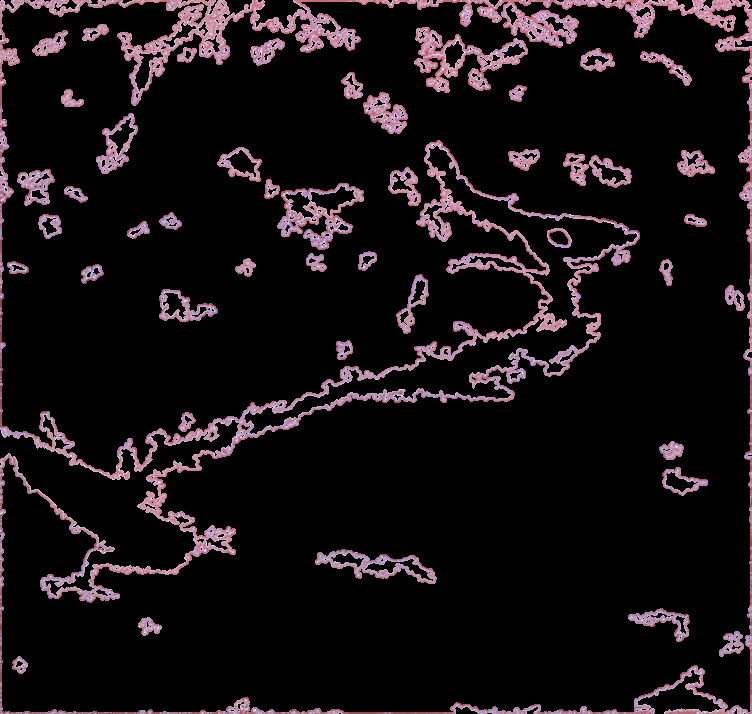

In [ ]:
#1. binarize the green component
  #a. get green component
  #b. binarize it
#2. use contouring


import cv2
from google.colab.patches import cv2_imshow
import imutils

def work():
  #read image
  img = cv2.imread('small_steak.jpg')

  #channel splitting
  blue, green, red = cv2.split(img)
  #cv2_imshow(green)

  #binarize green component w/ thresholding
  retval, dst	=	cv2.threshold(green, 150, 255, cv2.THRESH_BINARY_INV)
 # cv2_imshow(dst)


  #contouring

  contours, hierarchy = cv2.findContours(dst, cv2.RETR_TREE, cv2.CHAIN_APPROX_NONE)
  mask = np.zeros(image.shape[:2], dtype=image.dtype)

  # draw all contours larger than 20 on the mask
  for c in contours:
      if cv2.contourArea(c) > 100:
          x, y, w, h = cv2.boundingRect(c)
          cv2.drawContours(mask, [c], 0, (255), 2)

  # apply the mask to the original image
  result = cv2.bitwise_and(img,img, mask= mask)
  cv2_imshow(result)
  #cv2_imshow(image)

  cv2.waitKey(0)
  cv2.destroyAllWindows() 

  #final = cv2.drawContours(img, contours, -1, (0,0,0), 3)
  #cv2_imshow(final)


if __name__ == '__main__':
    work()

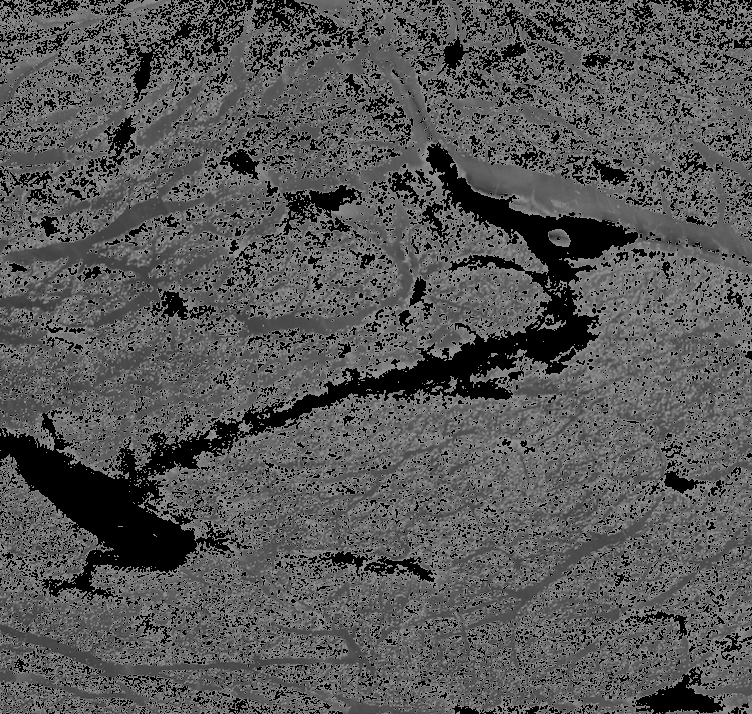

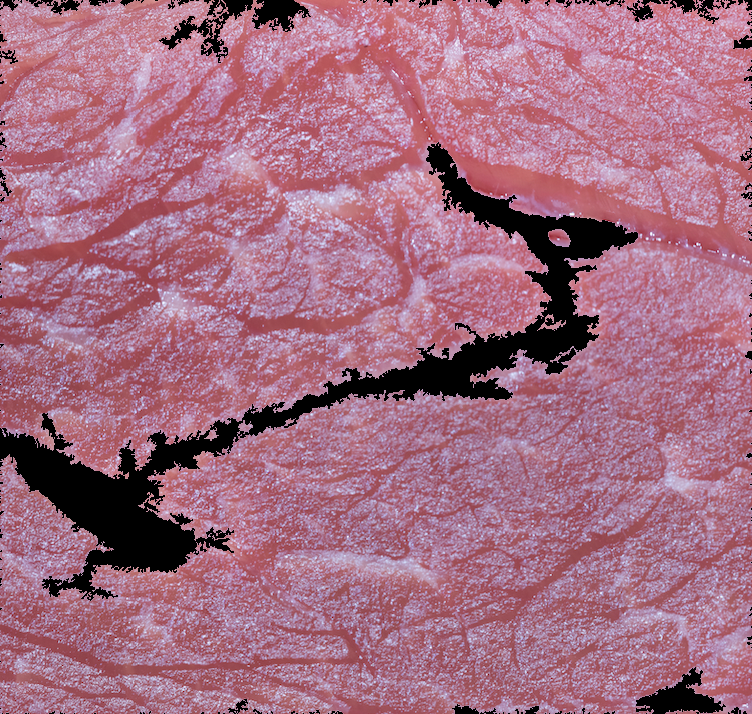

In [ ]:
#1. binarize the green component
  #a. get green component
  #b. binarize it
#2. use contouring


import cv2
from google.colab.patches import cv2_imshow
import imutils

def is_contour_bad(c):
	# approximate the contour
	peri = cv2.arcLength(c, True)
	approx = cv2.approxPolyDP(c, 0.02 * peri, True)
	# the contour is 'bad' if it is not a rectangle
	return not len(approx) == 4

def work():
  #read image
  img = cv2.imread('small_steak.jpg')

  #channel splitting
  blue, green, red = cv2.split(img)
  #cv2_imshow(green)

  #binarize green component w/ thresholding
  retval, dst	=	cv2.threshold(green, 150, 255, cv2.THRESH_TOZERO_INV)
  cv2_imshow(dst)


  #contouring

  contours, hierarchy = cv2.findContours(dst, cv2.RETR_TREE, cv2.CHAIN_APPROX_NONE)
  mask = np.zeros(image.shape[:2], dtype=image.dtype)

  # draw all contours larger than 20 on the mask
  for c in contours:
      if cv2.contourArea(c) > 100:
          x, y, w, h = cv2.boundingRect(c)
          cv2.drawContours(mask, [c], 0, (255), -1)

  # apply the mask to the original image
  result = cv2.bitwise_and(img,img, mask= mask)
  cv2_imshow(result)
  #cv2_imshow(image)

  cv2.waitKey(0)
  cv2.destroyAllWindows() 

  #final = cv2.drawContours(img, contours, -1, (0,0,0), 3)
  #cv2_imshow(final)


if __name__ == '__main__':
    work()

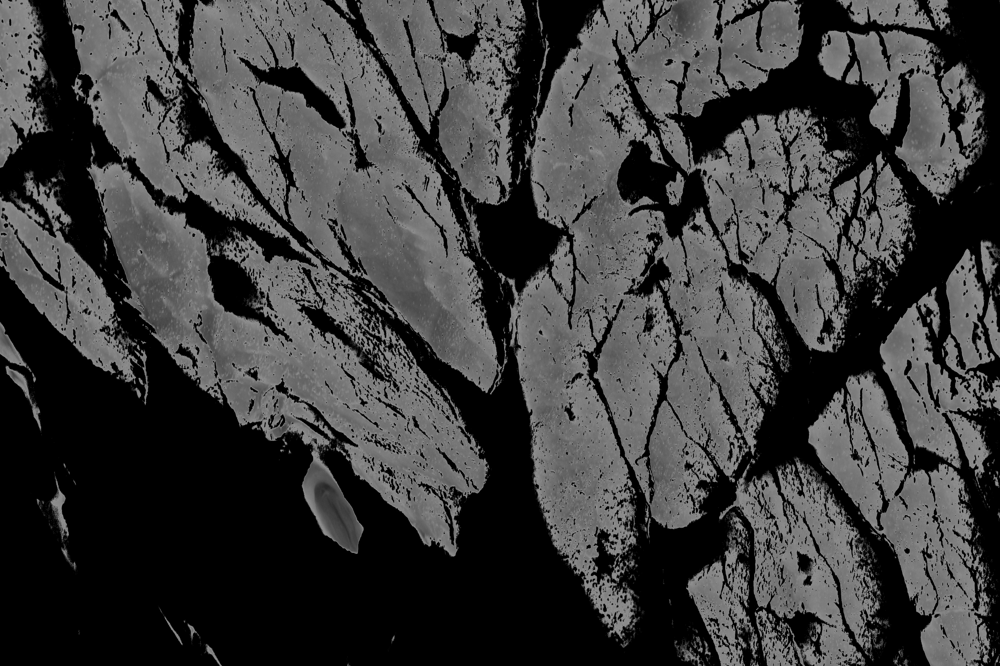

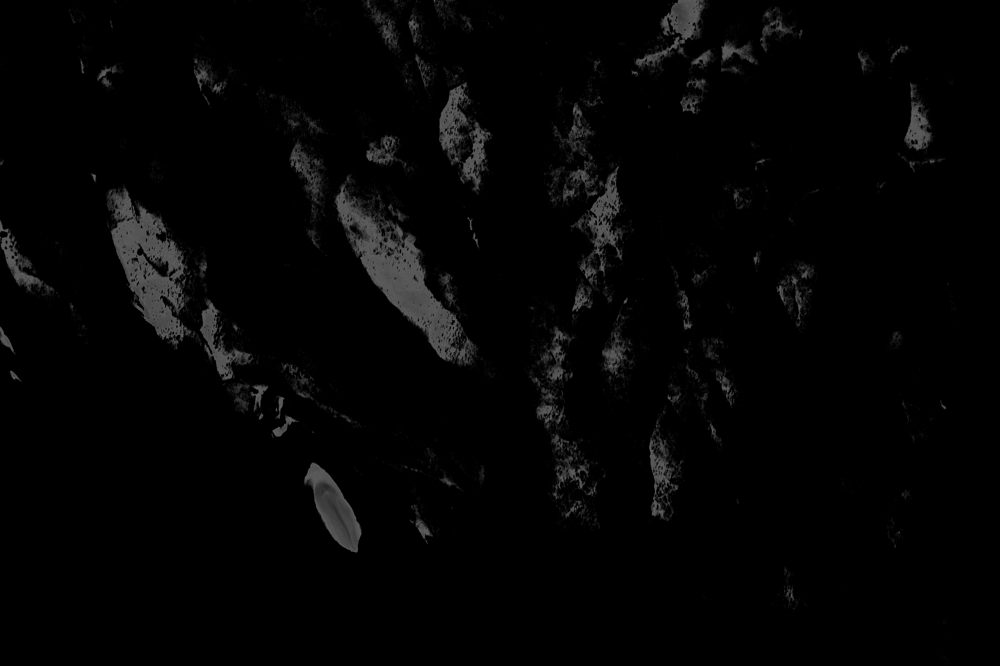

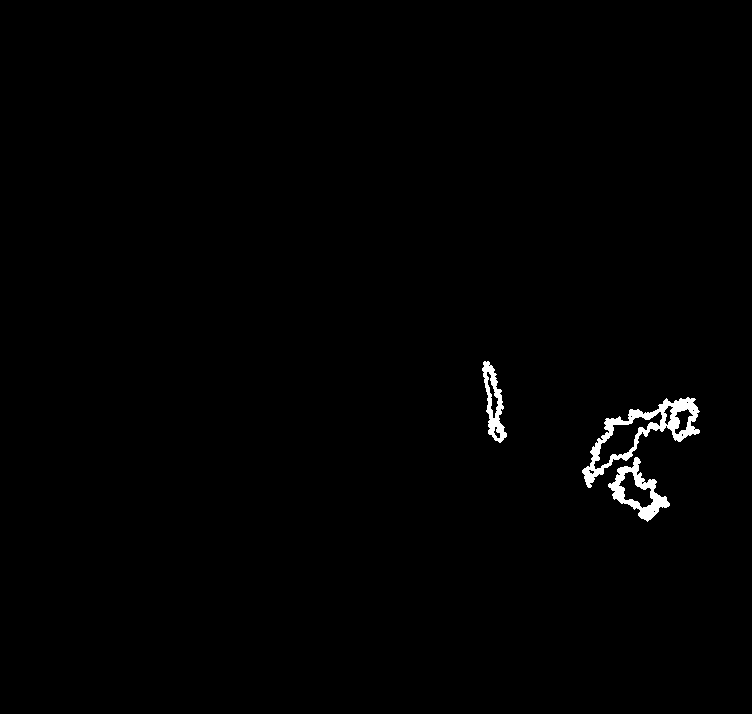

In [95]:
import cv2
from google.colab.patches import cv2_imshow
import imutils

def work():
  #read image
  img = cv2.imread('steak_clear.jpg')

  #channel splitting
  blue, green, red = cv2.split(img)
  #cv2_imshow(green)

  #binarize green component w/ thresholding
  retval, dst	=	cv2.threshold(green, 150, 255, cv2.THRESH_TOZERO_INV)
  cv2_imshow(dst)

  retval, dst	=	cv2.threshold(dst, 100, 255, cv2.THRESH_TOZERO_INV)
  cv2_imshow(dst)
  #contouring

  contours, hierarchy = cv2.findContours(dst, cv2.RETR_TREE, cv2.CHAIN_APPROX_NONE)
  mask = np.zeros(image.shape[:2], dtype=image.dtype)

  # draw all contours larger than 20 on the mask
  for c in contours:
      if cv2.contourArea(c) > 100:
          x, y, w, h = cv2.boundingRect(c)
          cv2.drawContours(mask, [c], 0, (255), 2)
          #cv2.drawContours(img, [c], 0, (255), 3)

  cv2_imshow(mask)
  # apply the mask to the original image
  #result = cv2.bitwise_and(img,img, mask= mask)
  #cv2_imshow(result)
  #cv2_imshow(image)

  cv2.waitKey(0)
  cv2.destroyAllWindows() 

  #final = cv2.drawContours(img, contours, -1, (0,0,0), 3)
  #cv2_imshow(final)


if __name__ == '__main__':
    work()

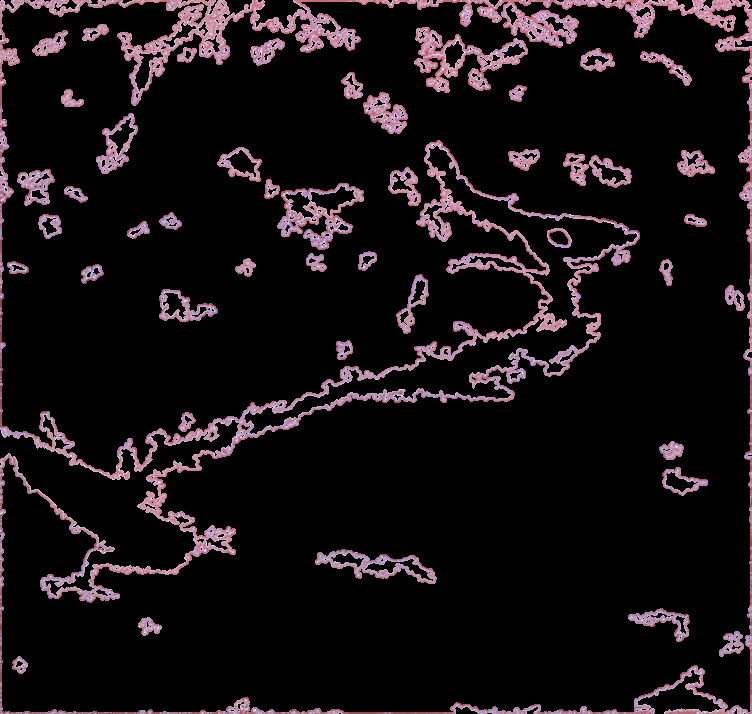

In [ ]:
import cv2
from google.colab.patches import cv2_imshow
import imutils

def work():
  #read image
  img = cv2.imread('small_steak.jpg')

  #channel splitting
  blue, green, red = cv2.split(img)
  #cv2_imshow(green)

  #binarize green component w/ thresholding
  retval, dst	=	cv2.threshold(green, 150, 255, cv2.THRESH_TOZERO_INV)
  #cv2_imshow(dst)

  retval, dst	=	cv2.threshold(dst, 10, 255, cv2.THRESH_TOZERO)
  #cv2_imshow(dst)
  #contouring

  contours, hierarchy = cv2.findContours(dst, cv2.RETR_TREE, cv2.CHAIN_APPROX_NONE)
  mask = np.zeros(image.shape[:2], dtype=image.dtype)

  # draw all contours larger than 20 on the mask
  for c in contours:
      if cv2.contourArea(c) > 100:
          x, y, w, h = cv2.boundingRect(c)
          cv2.drawContours(mask, [c], 0, (255), 2)

  # apply the mask to the original image
  result = cv2.bitwise_and(img,img, mask= mask)
  cv2_imshow(result)
  #cv2_imshow(image)

  cv2.waitKey(0)
  cv2.destroyAllWindows() 

  #final = cv2.drawContours(img, contours, -1, (0,0,0), 3)
  #cv2_imshow(final)


if __name__ == '__main__':
    work()

steak_clear.jpg

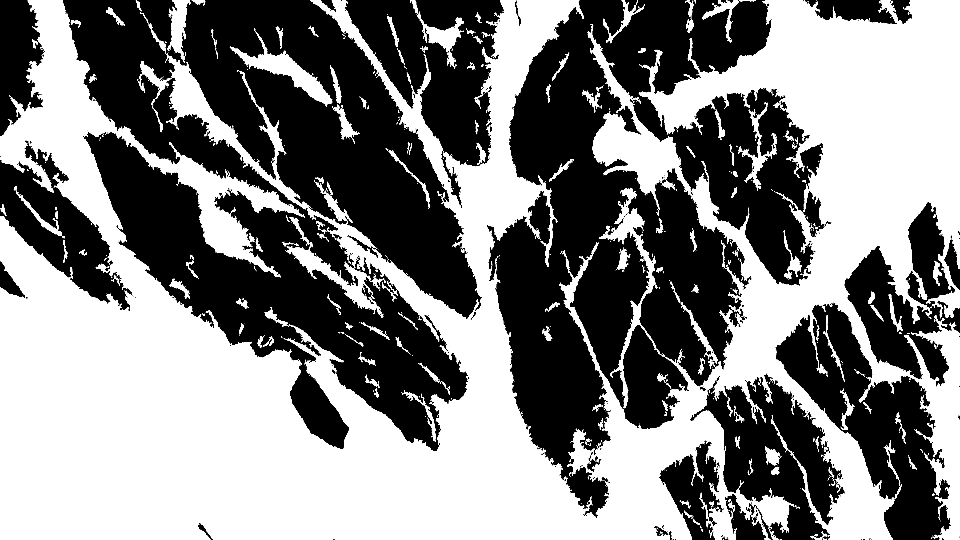

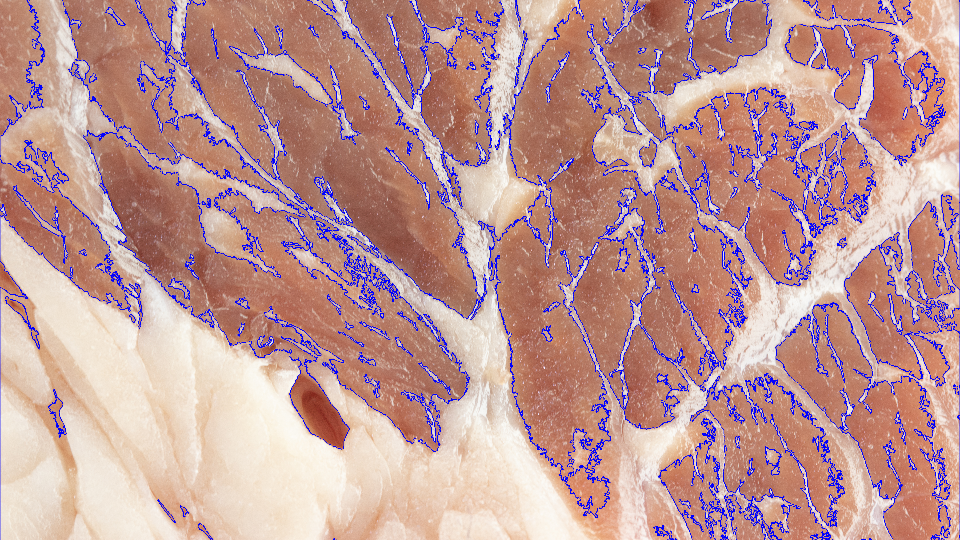

In [129]:
import cv2
from google.colab.patches import cv2_imshow
import imutils

def work():
  #read image
  img = cv2.imread('steak_clear.jpg')
  imgResized = cv2.resize(img, (960, 540))
  #cv2_imshow(imgResized)

  #channel splitting
  blue, green, red = cv2.split(img)
  #cv2_imshow(green)

  #binarize green component w/ thresholding
  retval, dst	=	cv2.threshold(green, 150, 255, cv2.THRESH_TOZERO)
  #cv2_imshow(dst)

  #retval, dst	=	cv2.threshold(dst, 100, 255, cv2.THRESH_TOZERO_INV)
  #cv2_imshow(dst)
  #contouring

  contours, hierarchy = cv2.findContours(dst, cv2.RETR_TREE, cv2.CHAIN_APPROX_NONE)
  mask = np.zeros(img.shape[:2], dtype=img.dtype)

  # draw all contours larger than 20 on the mask
  for c in contours:
      if cv2.contourArea(c) > 1000:
          x, y, w, h = cv2.boundingRect(c)
          cv2.drawContours(mask, [c], 0, (255), -1)
          cv2.drawContours(img, [c], 0, (255), 3)

  maskResized = cv2.resize(mask, (960, 540)) 
  #cv2_imshow(maskResized)
  # apply the mask to the original image
  #result = cv2.bitwise_and(img,img, mask= mask)
  #cv2_imshow(result)
  #cv2_imshow(image)

  cv2_imshow(maskResized)

  img_out_Resized = cv2.resize(img, (960, 540))
  cv2_imshow(img_out_Resized)

  cv2.waitKey(0)
  cv2.destroyAllWindows()   

#plt -- comp
'''
  fig1 = plt.figure(1, figsize=(20,20))
  fig1.show()
  ax1 = fig1.add_subplot(121)
  fig2 = plt.figure(2, figsize=(20,20))
  fig2.show()
  ax2 = fig2.add_subplot(122)
  ax1.imshow(imgResized)
  ax2.imshow(maskResized)
'''
  

  #final = cv2.drawContours(img, contours, -1, (0,0,0), 3)
  #cv2_imshow(final)


if __name__ == '__main__':
    work()